

*   Autor: Rafhael Eduardo Chavez Ramirez
*   Matricula: A00832228




#Motor de Búsqueda Basado en Contenido Utilizando Embeddings

Con el crecimiento de la información en la web, los motores de búsqueda juegan un papel crucial para encontrar contenido relevante. Este proyecto crea un motor de búsqueda basado en contenido utilizando embeddings, permitiendo realizar búsquedas semánticas más avanzadas

## Objetivos:

*   Crear un motor de búsqueda que permita encontrar páginas web basadas en su contenido, no solo en coincidencias exactas de palabras.

*   Comparar el desempeño de dos modelos de embeddings: uno personalizado con Word2Vec y un modelo preentrenado de Transformers, SentenceTransformer('all-MiniLM-L6-v2').


#Exploración y Entendimiento del Dataset

Para este proyecto, utilizamos el dataset "Website Classification", el cual contiene texto limpio extraído de varias páginas web y se clasifica en diferentes categorías basadas en su contenido. Este dataset se creó mediante scraping de sitios web y proporciona una base para explorar y construir un motor de búsqueda semántica.




In [2]:
import pandas as pd

df = pd.read_csv("website_classification.csv")

# Ver las primeras filas del dataset para confirmar que se ha cargado correctamente
print(df.head())



   Unnamed: 0                                        website_url  \
0           0     https://www.booking.com/index.html?aid=1743217   
1           1                   https://travelsites.com/expedia/   
2           2               https://travelsites.com/tripadvisor/   
3           3              https://www.momondo.in/?ispredir=true   
4           4  https://www.ebookers.com/?AFFCID=EBOOKERS-UK.n...   

                                cleaned_website_text Category  
0  official site good hotel accommodation big sav...   Travel  
1  expedia hotel book sites like use vacation wor...   Travel  
2  tripadvisor hotel book sites like previously d...   Travel  
3  cheap flights search compare flights momondo f...   Travel  
4  bot create free account create free account si...   Travel  


# Columnas del dataset

*   website_url: La URL de la página web de donde se extrajo el contenido. Esta columna permite identificar la fuente original del texto y es útil para presentar los resultados de búsqueda, ya que muestra el enlace a cada página web correspondiente.
*   cleaned_website_text: El texto limpio y preprocesado que se extrajo de la página web. Este texto es el contenido central del dataset y representa el material con el cual se entrenarán y aplicarán los modelos de embeddings para generar vectores semánticos. Este campo ya está preprocesado y libre de ruido (caracteres especiales, etiquetas HTML, etc.), facilitando el uso directo en los modelos.


In [3]:
# Ver las columnas del dataset
print("\nColumnas del dataset:")
print(df.columns)



Columnas del dataset:
Index(['Unnamed: 0', 'website_url', 'cleaned_website_text', 'Category'], dtype='object')


In [8]:
# Mostrar las primeras filas de 'cleaned_website_text' para ver ejemplos de contenido
print("Ejemplos de 'cleaned_website_text':")
print(df['cleaned_website_text'].head(5))

Ejemplos de 'cleaned_website_text':
0    official site good hotel accommodation big sav...
1    expedia hotel book sites like use vacation wor...
2    tripadvisor hotel book sites like previously d...
3    cheap flights search compare flights momondo f...
4    bot create free account create free account si...
Name: cleaned_website_text, dtype: object


Ejemplos de 'cleaned_website_text':
0    official site good hotel accommodation big sav...
1    expedia hotel book sites like use vacation wor...
2    tripadvisor hotel book sites like previously d...
3    cheap flights search compare flights momondo f...
4    bot create free account create free account si...
Name: cleaned_website_text, dtype: object

Longitud promedio de los textos en 'cleaned_website_text': 5274.67 caracteres


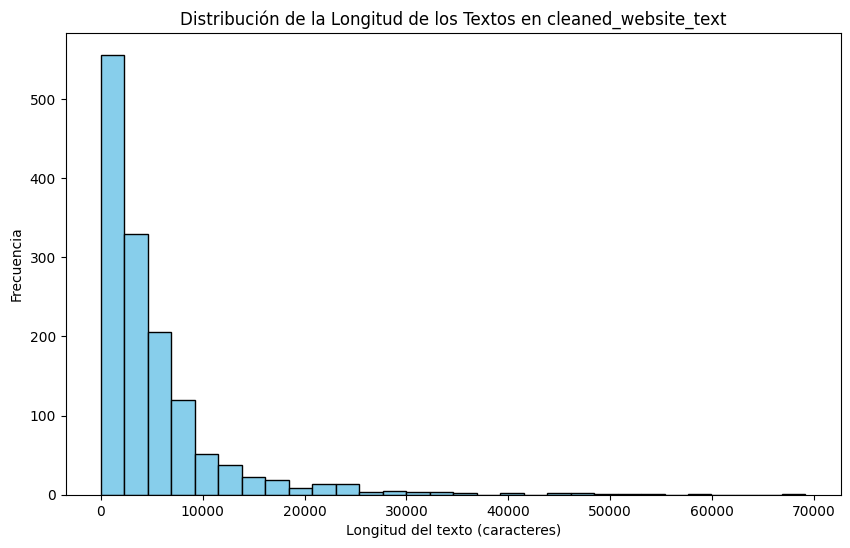

In [5]:
import pandas as pd
import matplotlib.pyplot as plt


# Calcular la longitud de cada texto en la columna 'cleaned_website_text'
df['text_length'] = df['cleaned_website_text'].apply(lambda x: len(str(x)))

# Calcular y mostrar la longitud promedio de los textos
longitud_promedio = df['text_length'].mean()
print(f"\nLongitud promedio de los textos en 'cleaned_website_text': {longitud_promedio:.2f} caracteres")

# Visualizar la distribución de la longitud de los textos
plt.figure(figsize=(10, 6))
plt.hist(df['text_length'], bins=30, color='skyblue', edgecolor='black')
plt.title('Distribución de la Longitud de los Textos en cleaned_website_text')
plt.xlabel('Longitud del texto (caracteres)')
plt.ylabel('Frecuencia')
plt.show()


Distribución de las categorías:
Category
Education                          114
Business/Corporate                 109
Travel                             107
Streaming Services                 105
Sports                             104
E-Commerce                         102
Games                               98
News                                96
Health and Fitness                  96
Photography                         93
Computers and Technology            93
Food                                92
Law and Government                  84
Social Networking and Messaging     83
Forums                              16
Adult                               16
Name: count, dtype: int64


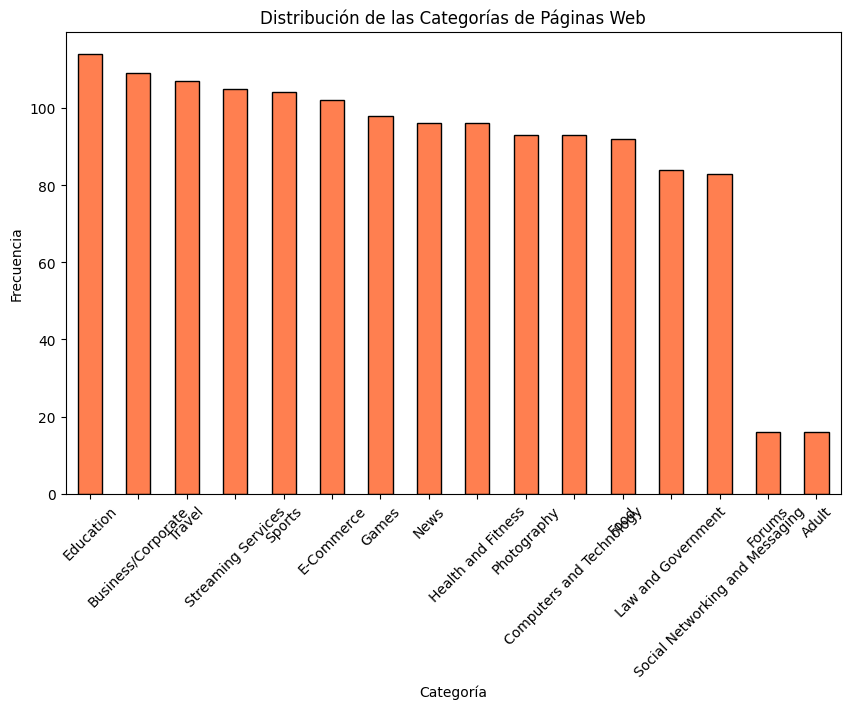

In [7]:
# Analizar la existencia y distribución de una columna de categorías (si existe)
if 'Category' in df.columns:
    print("\nDistribución de las categorías:")
    print(df['Category'].value_counts())

    # Visualización de la distribución de categorías
    plt.figure(figsize=(10, 6))
    df['Category'].value_counts().plot(kind='bar', color='coral', edgecolor='black')
    plt.title('Distribución de las Categorías de Páginas Web')
    plt.xlabel('Categoría')
    plt.ylabel('Frecuencia')
    plt.xticks(rotation=45)
    plt.show()
else:
    print("\nNo se encontró una columna de categorías en el dataset.")

#Generación de Nubes de Palabras por Categoría
se carga un archivo CSV que contiene un conjunto de datos con textos clasificados en diferentes categorías. Para cada categoría única en los datos, el código genera una nube de palabras que representa las palabras más frecuentes en los textos de esa categoría. Primero, se agrupan los textos por categoría y se crea una lista de categorías únicas. Luego, para cada categoría, se concatenan todos los textos pertenecientes a esa categoría y se utiliza la librería WordCloud para generar la nube de palabras. Las nubes de palabras se muestran en una cuadrícula (usando subgráficas) con un tamaño ajustado para una presentación visual más clara. El resultado es una visualización gráfica donde se puede observar de manera rápida qué palabras son más comunes en los textos de cada categoría, lo que facilita el análisis y la comprensión del contenido de los documentos agrupados por categoría.

['Travel' 'Social Networking and Messaging' 'News' 'Streaming Services'
 'Sports' 'Photography' 'Law and Government' 'Health and Fitness' 'Games'
 'E-Commerce' 'Forums' 'Food' 'Education' 'Computers and Technology'
 'Business/Corporate' 'Adult']


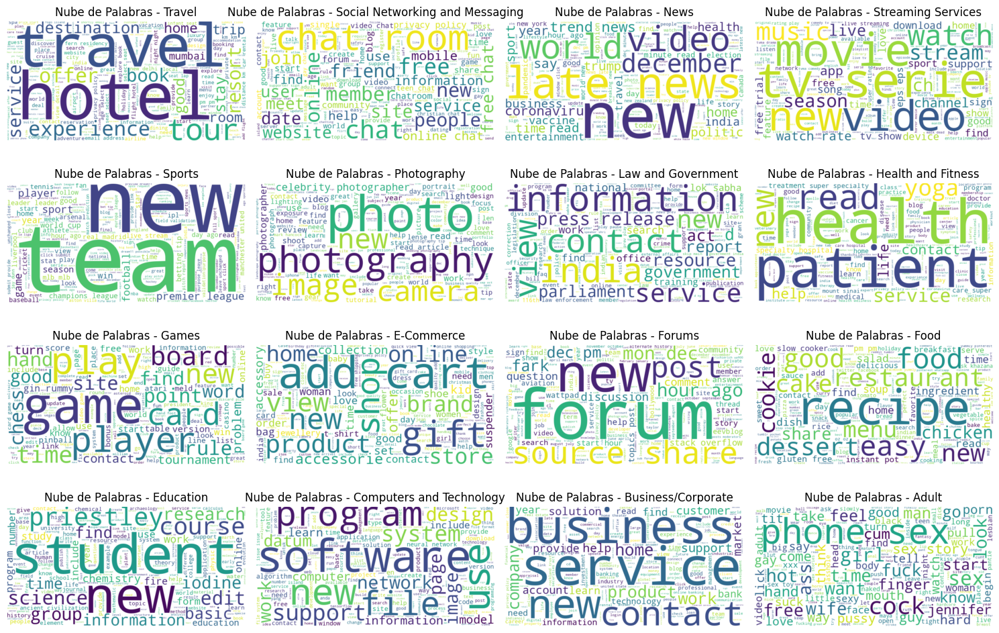

In [9]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Cargar el CSV y seleccionar la columna de texto que se va a clasificar
df = pd.read_csv('website_classification.csv')
cleaned_website_text = 'cleaned_website_text'
category = 'Category'

# Agrupar los textos por categoría
categories = df[category].unique()
print(categories)

# Crear una figura para las nubes de palabras
plt.figure(figsize=(15, 10))

# Crear una nube de palabras por categoría
for i, cat in enumerate(categories):
    plt.subplot(4, 4, i+1)
    # Concatenar los textos de los documentos de la categoría
    text = ' '.join(df[df[category] == cat][cleaned_website_text])

    # Generar la nube de palabras
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

    # Mostrar la nube de palabras
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Nube de Palabras - {cat}')

# Mostrar todas las nubes de palabras
plt.tight_layout()
plt.show()


In [ ]:
!pip install anvil-uplink

  Using cached argparse-1.4.0-py2.py3-none-any.whl.metadata (2.8 kB)
Using cached argparse-1.4.0-py2.py3-none-any.whl (23 kB)


#Motor de Búsqueda Semántica con Word2Vec

utilizaremos el modelo de embeddings Word2Vec, que transformará las palabras en vectores en un espacio semántico, permitiendo buscar contenido similar basado en la proximidad entre estos vectores.

#Preprocesamiento de Datos
El texto en bruto a menudo incluye ruido, palabras vacías y otros elementos que no son útiles para el análisis semántico. Nuestro primer paso es preprocesar este texto.

#Tokenización y Preprocesamiento de Texto con NLTK


Tokenización y Preprocesamiento de Texto con NLTK
Este código carga un archivo CSV que contiene una columna de texto llamada cleaned_website_text y utiliza NLTK para tokenizar cada línea de texto en palabras. Primero, se descargan los recursos necesarios (punkt para tokenización y stopwords para palabras vacías), luego se define una función llamada preprocess_text que toma un texto como entrada y lo convierte en una lista de palabras usando word_tokenize(). Después, se extrae la columna de texto del DataFrame y se aplica la función de preprocesamiento a cada línea, generando una lista de listas, donde cada sublista contiene las palabras tokenizadas de cada línea. Este enfoque permite realizar un procesamiento más avanzado de lenguaje natural en el texto

In [ ]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import pandas as pd
import re

# Descargar recursos de NLTK
nltk.download('punkt')
nltk.download('stopwords')

# Cargar el CSV y seleccionar la columna de texto que se va a clasificar
df = pd.read_csv('website_classification.csv')
cleaned_website_text = 'cleaned_website_text'

# Función de preprocesamiento
def preprocess_text(text):
    # Tokenizar palabras
    words = word_tokenize(text)
    return words

#texto de entrada
corpus = df[cleaned_website_text]

# Procesar el corpus
processed_corpus = [preprocess_text(sentence) for sentence in corpus]
print(processed_corpus)


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


[['official', 'site', 'good', 'hotel', 'accommodation', 'big', 'saving', 'hotel', 'destination', 'worldwide', 'browse', 'hotel', 'review', 'find', 'guarantee', 'good', 'price', 'hotel', 'budget', 'lodging', 'accommodation', 'hotel', 'hotels', 'special', 'offer', 'package', 'special', 'weekend', 'break', 'city', 'break', 'deal', 'budget', 'cheap', 'discount', 'saving', 'select', 'language', 'find', 'deal', 'hotel', 'home', 'try', 'search', 'connect', 'traveller', 'india', 'travel', 'talk', 'community', 'recommend', 'destination', 'flamborough', 'boreland', 'colvend', 'catfield', 'harberton', 'warleggan', 'inspiration', 'trip', 'spot', 'winter', 'wildlife', 'beautiful', 'snowy', 'island', 'bye', 'bye', 'work', 'want', 'spontechnaity', 'tech', 'drive', 'travel', 'vital', 'value', 'maximise', 'travel', 'homes', 'guest', 'love', 'browse', 'property', 'type', 'hotels', 'apartments', 'resorts', 'villa', 'cabins', 'cottage', 'glamping', 'serviced', 'apartment', 'holiday', 'home', 'guest', 'hou

# Creación y Entrenamiento del Modelo Word2Vec
Para construir los embeddings de cada palabra, entrenamos un modelo Word2Vec usando el corpus de páginas web.

##Parámetros del Modelo


*   vector_size: La dimensión del espacio vectorial donde se representarán las palabras.
*   window: El número de palabras de contexto alrededor de cada palabra.
*   min_count: La frecuencia mínima que debe tener una palabra para ser incluida en el vocabulario del modelo.
*   workers: Número de procesadores en paralelo para el entrenamiento.



#Entrenamiento de un Modelo Word2Vec para Representación de Palabras

se utiliza la biblioteca Gensim para entrenar un modelo Word2Vec, que convierte palabras en vectores numéricos basados en su contexto en el texto. El modelo se configura con varios parámetros clave: sentences define el corpus preprocesado (processed_corpus) que contiene las listas de palabras tokenizadas; vector_size=100 especifica la dimensión de los vectores de palabra; window=5 establece el tamaño de contexto, es decir, cuántas palabras a la izquierda y derecha de cada palabra se consideran en su representación; min_count=1 asegura que todas las palabras con una frecuencia de aparición de al menos 1 sean incluidas; y workers=4 indica que se usarán cuatro threads para procesar los datos en paralelo. Tras definir el modelo, el código entrena el modelo sobre el corpus durante 10 épocas y finalmente guarda el modelo entrenado en un archivo llamado "word2vec_custom.model", permitiendo su uso posterior.

In [ ]:
from gensim.models import Word2Vec

# Definir parámetros del modelo
model = Word2Vec(
    sentences=processed_corpus,  # Corpus preprocesado
    vector_size=100,            # Dimensión de los vectores de palabras
    window=5,                   # Contexto (número de palabras alrededor)
    min_count=1,                # Palabras con frecuencia mínima para ser incluidas
    workers=4                   # Número de threads (procesamiento paralelo)
)

# Entrenar el modelo
model.train(processed_corpus, total_examples=len(processed_corpus), epochs=10)

# Guardar el modelo
model.save("word2vec_custom.model")


#Uso del Modelo Word2Vec
Para comprobar que el modelo funciona correctamente, probamos dos tareas:


*   Obtener el vector de una palabra específica ('taxi' en este caso).
*   Buscar palabras semánticamente similares usando el vector de 'taxi'.





#Carga y Uso de un Modelo Word2Vec para Obtener Vectores de Palabras
carga un modelo Word2Vec previamente entrenado desde el archivo "word2vec_custom.model" y luego obtiene el vector de una palabra específica, en este caso 'taxi'. La línea model.wv['taxi'] accede al vector asociado con la palabra 'taxi' en el espacio vectorial del modelo, que representa las características semánticas de la palabra en función de su contexto en el corpus. Finalmente, imprime este vector, permitiendo observar cómo el modelo representa la palabra seleccionada en un formato numérico adecuado para análisis y tareas de procesamiento de lenguaje natural.

In [ ]:
# Cargar el modelo
model = Word2Vec.load("word2vec_custom.model")

# Obtener el vector de una palabra
word_vector = model.wv['taxi']
print(word_vector)


[ 1.5451198   1.1518484   1.3428041  -0.07388699  0.96454823 -1.2648127
 -0.44314882  0.81779325 -0.34161946  0.12942949 -0.9884006   0.04779889
  0.11007943  0.3206268   0.85060734 -1.082496    2.183272   -1.1663439
  0.83558863 -0.3053435   0.43122017  0.8241724  -0.22586529 -0.5821193
  0.52362    -2.3918126  -0.26335865  1.7173303  -0.6703049  -0.91017246
 -0.69193363 -1.8042028   0.15892391 -1.2787338   0.27162147  1.4486889
 -1.3424675  -0.3556234   1.1980577   0.29115787  0.39828876  0.44468957
  1.2819031   0.58333534 -0.32127896  0.6204863  -1.6097794  -1.6117778
  0.25033402  0.14398324 -0.63745904 -0.96181935 -1.4802455  -1.9241023
  1.1913856   1.2350816  -0.72636414  0.9637275   0.39659435  0.733353
 -1.120352    0.7323104   0.57709885  2.105935    0.29928595 -0.02182995
 -0.33076566  1.1546993   1.1180923  -0.80731833 -0.45365992 -2.4765472
  0.02336064  0.17725497 -0.46944502  2.1768198   0.6675914   0.55418855
  0.6966618   0.8515937  -1.5056283   0.06323642 -1.8452414 

#Obtención de Palabras Similares en un Modelo Word2Vec
utiliza el modelo Word2Vec para encontrar palabras que son semánticamente similares a 'taxi'. La función model.wv.most_similar('taxi', topn=5) busca en el espacio vectorial las cinco palabras más cercanas a 'taxi' en términos de similitud de coseno, que mide cómo de similares son los vectores. El resultado es una lista de las palabras más similares junto con sus puntuaciones de similitud, las cuales se imprimen para examinar cómo el modelo ha capturado relaciones de significado entre palabras en el corpus.

In [ ]:
# Palabras similares a 'taxi'
similar_words = model.wv.most_similar('taxi', topn=5)
print(similar_words)


[('cab', 0.8654263019561768), ('hatchback', 0.8124788999557495), ('sedan', 0.8101136088371277), ('limo', 0.8059062957763672), ('outstation', 0.7636046409606934)]


#Implementación del Motor de Búsqueda con Similitud de Coseno
El siguiente paso es construir el motor de búsqueda. Para ello, convertimos cada texto de página en un vector promedio, lo que nos permite comparar cada página con una consulta usando similitud de coseno.
##Funciones de Similitud


*   Vector promedio: Calculamos el vector promedio de las palabras en cada texto.

*   Similitud de coseno: Comparamos el vector de la consulta con cada vector promedio de los textos.



#Búsqueda de Textos Relevantes Usando Similitud de Coseno
Calcula la relevancia de cada texto en el corpus con respecto a una palabra de consulta, en este caso, 'book', utilizando la similitud de coseno. Primero, define una función average_vector que calcula el vector promedio de un texto tomando los vectores de cada palabra del texto (solo si están en el vocabulario del modelo). Luego, obtiene el vector de la palabra de consulta (query_vector) y, para cada texto en el corpus (processed_corpus), calcula la similitud de coseno entre el vector de consulta y el vector promedio del texto. Estas similitudes se guardan junto con el índice del texto en la lista similarities. Finalmente, los textos se ordenan en orden descendente de similitud y se imprime una lista de los textos más relevantes, mostrando su similitud respecto a la palabra de consulta 'book'.

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

# Función para calcular el vector promedio de un texto
def average_vector(text):
    vectors = [model.wv[word] for word in text if word in model.wv]
    return np.mean(vectors, axis=0) if vectors else np.zeros(model.vector_size)

# Vector de la palabra de consulta
query = "book"
query_vector = model.wv[query]

# Calcular la similitud de coseno para cada texto en el corpus
similarities = []
for i, text in enumerate(processed_corpus):
    text_vector = average_vector(text)
    similarity = cosine_similarity([query_vector], [text_vector])[0][0]
    similarities.append((i, similarity))

# Ordenar los textos por relevancia
sorted_texts = sorted(similarities, key=lambda x: x[1], reverse=True)

# Mostrar los textos más relevantes
print("Textos más relevantes para la palabra de consulta:")
for i, sim in sorted_texts:
    print(f"Texto {i}: {corpus[i]} (Similitud: {sim})")


Textos más relevantes para la palabra de consulta:
Texto 82: british airways book flights holidays city breaks check online save worldwide flight holiday book directly british airways browse guide find great deal manage booking check online (Similitud: 0.6433857679367065)
Texto 84: singapore airlines official website book international flight tickets book flight ticket singapore international destination singapore airlines plan holiday late travel deal promotion (Similitud: 0.5435537099838257)
Texto 9: cheap hotels cars flights minute travel deals hotwire find good deal cheap hotel car flight hotwire save hotel rent car day favorite destination (Similitud: 0.5410105586051941)
Texto 86: book reliable safe cab service india affordable authorised airport taxi service meru offer hassle free comfortable affordable taxi cab service nearby location travel city outstation india book sedan hatchback suv meru app website india trusted car rental service ac cabs advance booking low fare train dri

#verificacion de resultados con clusters

#Selección del Número de Clústeres con el Método del Codo
utiliza el algoritmo K-means para encontrar el número óptimo de clústeres en el espacio vectorial de palabras generado por el modelo Word2Vec. Primero, obtiene los vectores de todas las palabras en el vocabulario y los almacena en word_vectors. Luego, utiliza K-means para calcular la suma de los errores cuadráticos (SSE o inercia) para diferentes cantidades de clústeres (del 1 al 30). La inercia mide qué tan bien se ajustan las palabras al clúster más cercano, siendo menor cuando los puntos están más cerca del centro de su clúster. Finalmente, se grafica la inercia contra el número de clústeres, creando un gráfico donde se puede aplicar el "método del codo" para identificar visualmente el número de clústeres más adecuado: el punto donde la curva comienza a aplanarse (indicando una menor ganancia de agrupamiento adicional).

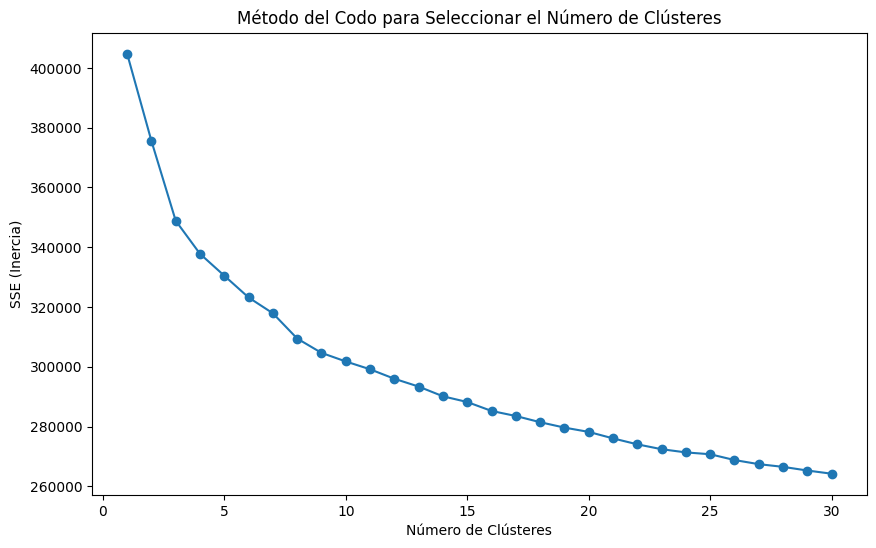

In [ ]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
# Obtener los vectores de todas las palabras en el vocabulario
words = list(model.wv.index_to_key)
word_vectors = model.wv[words]

# Calcular inercia para diferentes números de clústeres
sse = []
k_values = range(1, 31)  # Probar con 1 a 30 clústeres

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=0).fit(word_vectors)
    sse.append(kmeans.inertia_)

# Graficar el método del codo
plt.figure(figsize=(10, 6))
plt.plot(k_values, sse, marker='o')
plt.xlabel('Número de Clústeres')
plt.ylabel('SSE (Inercia)')
plt.title('Método del Codo para Seleccionar el Número de Clústeres')
plt.show()


# Visualización de Clústeres de Palabras en 2D con t-SNE y K-means
se crea una visualización bidimensional de los clústeres de palabras generados a partir de un modelo Word2Vec. Primero, selecciona las primeras 600 palabras y sus vectores correspondientes para reducir la cantidad de datos a visualizar. Luego, utiliza t-SNE, un algoritmo de reducción de dimensionalidad, para transformar estos vectores de alta dimensión en coordenadas 2D, facilitando la visualización.

Para cada clúster, identificado mediante el algoritmo K-means, se asigna un color específico. Se usa plt.scatter para graficar las palabras en función de su coordenada t-SNE, y cada clúster se representa con un color diferente. Opcionalmente, se agregan etiquetas a cada 20 palabras para mejorar la interpretabilidad del gráfico. Finalmente, se muestra el gráfico con una leyenda para cada clúster, proporcionando una representación visual de las agrupaciones de palabras en función de su similitud semántica.

<ipython-input-24-de26c893d435>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', len(unique_clusters))


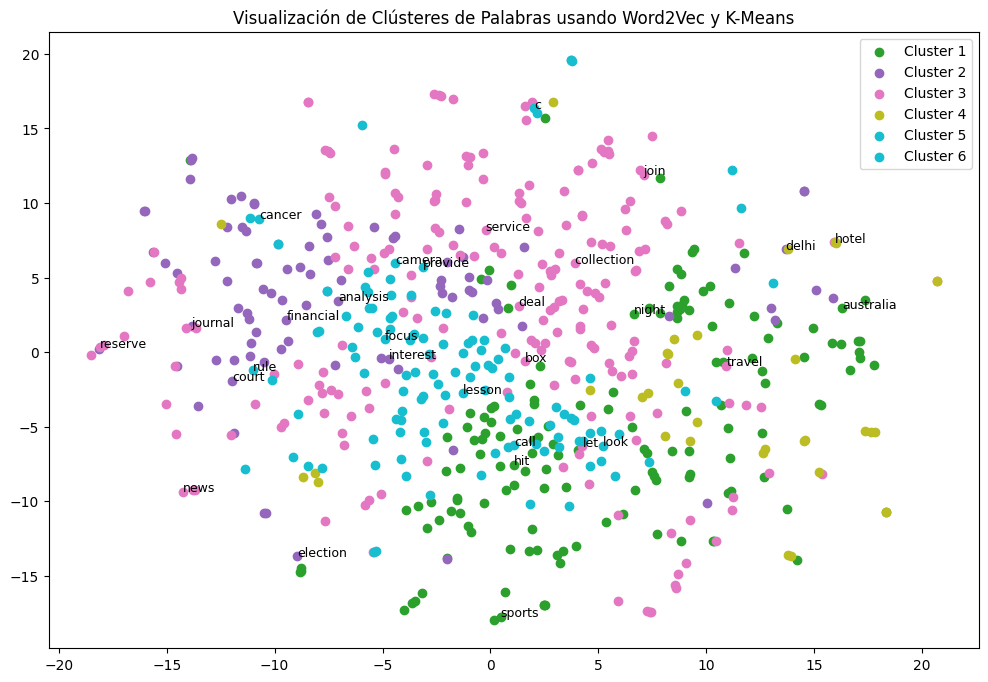

In [ ]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import numpy as np

# Selecciona una cantidad de palabras para visualizar (por ejemplo, las primeras 300)
n_words = 600
selected_words = words[:n_words]
selected_word_vectors = word_vectors[:n_words]

# Reducir a 2D usando t-SNE
tsne = TSNE(n_components=2, random_state=0, perplexity=40)
word_vectors_2d = tsne.fit_transform(selected_word_vectors)

# Crear una lista de colores basada en los clústeres
selected_clusters = clusters[:n_words]
unique_clusters = np.unique(selected_clusters)
colors = plt.cm.get_cmap('tab10', len(unique_clusters))

# Visualizar los resultados
plt.figure(figsize=(12, 8))
for cluster in unique_clusters:
    indices = [i for i, label in enumerate(selected_clusters) if label == cluster]
    cluster_words_2d = word_vectors_2d[indices]
    plt.scatter(cluster_words_2d[:, 0], cluster_words_2d[:, 1], label=f'Cluster {cluster}', color=colors(cluster))

# Opcional: añadir etiquetas a algunas palabras
for i in range(0, n_words, 20):  # Añadir etiquetas para cada 20 palabras
    plt.text(word_vectors_2d[i, 0], word_vectors_2d[i, 1], selected_words[i], fontsize=9)

plt.title("Visualización de Clústeres de Palabras usando Word2Vec y K-Means")
plt.legend()
plt.show()


#Resultados y Conclusión
El modelo Word2Vec ha sido entrenado exitosamente en el corpus y muestra buenos resultados en términos de similitud semántica entre la consulta y el contenido de las páginas web. Al realizar búsquedas con este motor, podemos observar que el modelo es capaz de identificar los textos más relevantes y cercanos en significado a la consulta, mostrando así su potencial como motor de búsqueda semántico.
Uno de los problemas principales es que no se puede usar para busquedas de mas de una palabra y ademas si la palabra no esta en el corpus el modelo no puedo ser utilizado



In [ ]:

import anvil.server

anvil.server.connect("server_WOXUP22FHLLPYBI3ALCYDT2K-UPZIRYSPWPSU7WKV")

Connecting to wss://anvil.works/uplink
Anvil websocket open
Connected to "Default Environment" as SERVER


In [ ]:
pip install wordcloud matplotlib

#Motor de Búsqueda Semántica con Sentence-BERT
Utilizaremos Sentence-BERT, un modelo basado en transformadores que ha sido preentrenado para capturar la semántica de frases y documentos, lo que resulta ideal para tareas de similitud textual y recuperación de información.

##¿Por qué Sentence-BERT?
A diferencia de modelos tradicionales como Word2Vec, que genera embeddings para cada palabra individualmente, Sentence-BERT crea un vector de embeddings para frases completas. Esto permite que el modelo capte el significado de frases y textos de forma contextual, siendo especialmente útil para el tipo de búsqueda que queremos implementar.

#Cargando y Preprocesando los Datos
Comenzamos cargando el dataset y preparando el texto para generar embeddings con Sentence-BERT. En esta sección, separamos la columna de texto y creamos una lista de tuplas que contiene el texto, la URL y la categoría de cada página web.

# Cálculo y Almacenamiento de Embeddings de Texto con Sentence-BERT
Se utiliza el modelo preentrenado Sentence-BERT (all-MiniLM-L6-v2) para calcular los embeddings (representaciones vectoriales) de los textos en un archivo CSV. Primero, se carga el CSV website_classification.csv y se extraen tres columnas de interés: el texto (cleaned_website_text), la URL (website_url) y la categoría (Category). Luego, se crea una lista de tuplas que contienen el texto, la URL y la categoría de cada fila. Usando Sentence-BERT, se generan embeddings para el texto de cada documento (es decir, solo la primera entrada de cada tupla). Estos embeddings, que representan las características semánticas de los textos, se almacenan en un archivo llamado embeddings_documentos.npy, permitiendo su reutilización en tareas posteriores, como clasificación o búsqueda de similitud.

In [ ]:
import numpy as np
import pandas as pd
from sentence_transformers import SentenceTransformer

# Cargar el modelo preentrenado de Sentence-BERT
model = SentenceTransformer('all-MiniLM-L6-v2')

# Cargar el CSV y seleccionar la columna de texto que se va a clasificar
df = pd.read_csv('website_classification.csv')
cleaned_website_text = 'cleaned_website_text'
website_url = 'website_url'
category = 'Category'

# Crear lista de tuplas con (documento, url)
documentos = list(zip(df['cleaned_website_text'], df[website_url], df[category]))



/usr/local/lib/python3.10/dist-packages/sentence_transformers/cross_encoder/CrossEncoder.py:13: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

#Generación de Embeddings para el Corpus
Cada página web en el dataset se representa como un vector de embeddings usando Sentence-BERT. Estos vectores capturan el significado semántico de cada texto, lo que facilita el cálculo de similitudes con futuras consultas de búsqueda.

In [ ]:
# Calcular los embeddings solo del texto del documento
embeddings_docs = model.encode([doc[0] for doc in documentos])  # Solo el texto del documento
np.save('embeddings_documentos.npy', embeddings_docs)           # Guardar los embeddings

#Agrupación de Documentos Usando K-means y Visualización de Resultados por Clúster
Este código agrupa documentos en 14 clústeres (o el número especificado en num_clusters) utilizando el algoritmo de K-means sobre embeddings preexistentes de textos cargados desde embeddings_documentos.npy. Primero, se inicializa K-means con el número deseado de clústeres y luego se ajusta (fit) a los embeddings de los documentos, asignando cada uno a un clúster. Los resultados de la agrupación se añaden como una nueva columna cluster en el DataFrame df. Finalmente, el código imprime los documentos organizados por clúster, mostrando para cada documento su URL, categoría y contenido, permitiendo analizar la composición y temática de cada grupo resultante

In [ ]:
# Aplicar KMeans
num_clusters = 14  # Cambiar el número de clusters según sea necesario
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
embeddings_docs = np.load('embeddings_documentos.npy')
kmeans.fit(embeddings_docs)

# Añadir los labels de cluster a los documentos
df['cluster'] = kmeans.labels_

# Mostrar los documentos agrupados por cluster
for cluster_num in range(num_clusters):
    print(f"\nCluster {cluster_num}:")
    cluster_docs = df[df['cluster'] == cluster_num]
    for index, row in cluster_docs.iterrows():
        print(f"URL: {row[website_url]}, Categoría: {row[category]}, Documento: {row[cleaned_website_text]}")


Cluster 0:
URL: https://www.fubo.tv/lp/StreamTV/?irad=343747&irmp=398453&subId1=streamingservices&subId2=ckhgo1ujg00003r8zaneft7pl, Categoría: Streaming Services, Documento: stream live tv sports fubotv free trial sport deporte nfl nhl mba mlb baseball football soccer cycling watch stream ondemand demand live stream live tv abc cbs fox nbc espn channel cable dvr include start watch free contract cancel anytime stream live tv sports device anytime watch dvr channel love contract commitment enjoy free trial stream live tv channels love start free cancel online anytime fubotv well cable tv big saving contract hidden fee cloud dvr include free stream live demand favorite device frequently ask question start free trial know offer free trial email start free channel love cancel online anytime start free cut cable channel love channel cable tv fubotv live sport tv love half cost similar cable package pay want cancel break problem hour free record want watch device start free cancel online an

#verificacion de resultados con clusters

#Método del Codo para Determinar el Número Óptimo de Clústeres
se utiliza el método del codo para determinar el número óptimo de clústeres en un conjunto de documentos basados en sus embeddings. Primero, carga los embeddings previamente calculados de los documentos desde un archivo .npy. Luego, evalúa la inercia (o suma de los errores cuadráticos dentro de los clústeres) para una variedad de números de clústeres, desde 1 hasta 20. La inercia se calcula para cada valor de clúster utilizando el algoritmo K-means. Finalmente, se grafica la inercia contra el número de clústeres, lo que permite aplicar el "método del codo". Este método consiste en identificar el punto donde la curva de inercia deja de disminuir significativamente, indicando el número óptimo de clústeres.


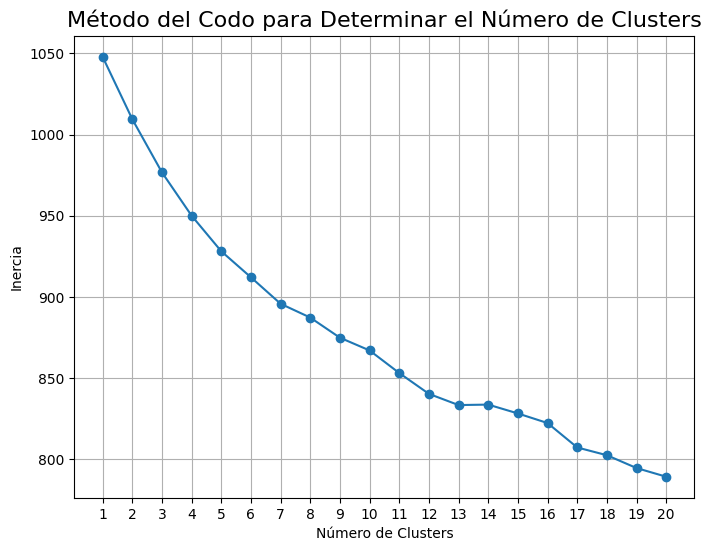

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Cargar los embeddings precalculados
embeddings_docs = np.load('embeddings_documentos.npy')

# Calcular la inercia para un rango de números de clusters
inercia = []
range_n_clusters = range(1, 21)  # Evaluar entre 1 y 20 clusters

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(embeddings_docs)
    inercia.append(kmeans.inertia_)

# Graficar el método del codo
plt.figure(figsize=(8, 6))
plt.plot(range_n_clusters, inercia, marker='o')
plt.title('Método del Codo para Determinar el Número de Clusters', fontsize=16)
plt.xlabel('Número de Clusters')
plt.ylabel('Inercia')
plt.xticks(range_n_clusters)
plt.grid(True)
plt.show()


#Evaluación del Número Óptimo de Clústeres Usando Silhouette Score
se utiliza el Silhouette Score para evaluar la calidad de la agrupación de documentos con diferentes números de clústeres, utilizando K-means. Primero, se cargan los embeddings previamente calculados de los documentos desde un archivo .npy. Luego, el código evalúa el rendimiento de K-means para un rango de clústeres, desde 2 hasta 20, calculando el Silhouette Score para cada uno. Este score mide qué tan similar es un punto dentro de su propio clúster en comparación con los puntos de otros clústeres, siendo un valor cercano a 1 indicativo de una buena agrupación. Finalmente, los resultados se grafican, lo que permite visualizar el comportamiento del Silhouette Score frente al número de clústeres y ayudar a seleccionar el número óptimo de clústeres con base en el valor más alto del score.

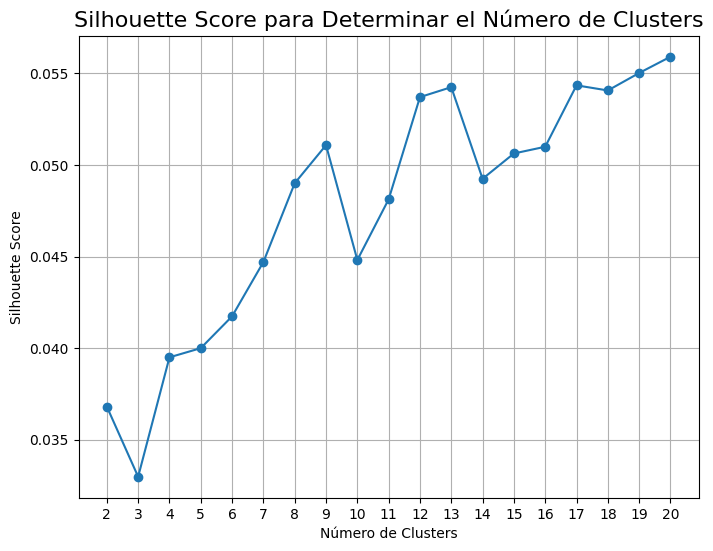

In [ ]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import numpy as np
import matplotlib.pyplot as plt

# Cargar los embeddings precalculados
embeddings_docs = np.load('embeddings_documentos.npy')

# Calcular el Silhouette Score para diferentes números de clusters
silhouette_scores = []
range_n_clusters = range(2, 21)  # Evaluar entre 2 y 20 clusters

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(embeddings_docs)
    score = silhouette_score(embeddings_docs, kmeans.labels_)
    silhouette_scores.append(score)

# Graficar el Silhouette Score
plt.figure(figsize=(8, 6))
plt.plot(range_n_clusters, silhouette_scores, marker='o')
plt.title('Silhouette Score para Determinar el Número de Clusters', fontsize=16)
plt.xlabel('Número de Clusters')
plt.ylabel('Silhouette Score')
plt.xticks(range_n_clusters)
plt.grid(True)
plt.show()


#Visualización de Clústeres con PCA
se aplica un modelo de clustering K-means para agrupar documentos en 13 clústeres utilizando embeddings pre-calculados. Después de aplicar K-means, se asigna a cada documento un label correspondiente al clúster al que pertenece. Para facilitar la visualización, se utiliza la técnica de reducción de dimensionalidad PCA (Análisis de Componentes Principales), reduciendo los embeddings de alta dimensión a dos dimensiones para poder graficarlos. Luego, se crea una visualización en 2D donde los puntos representan los documentos, coloreados según el clúster al que pertenecen. Esto permite observar cómo los clústeres están distribuidos en el espacio reducido y obtener una visión más clara de las relaciones entre los documentos agrupados. La gráfica muestra los puntos con un mapa de colores que indica los diferentes clústeres, facilitando la interpretación de los resultados.

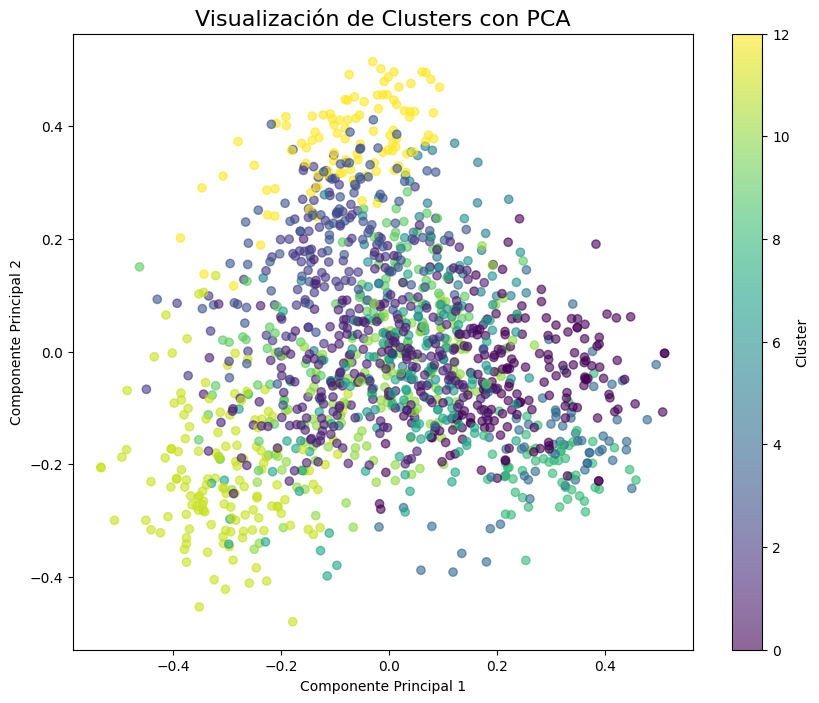

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

# Cargar los embeddings precalculados
embeddings_docs = np.load('embeddings_documentos.npy')

# Aplicar KMeans
num_clusters = 13
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(embeddings_docs)

# Añadir los labels de cluster a los documentos
df['cluster'] = kmeans.labels_

# Reducir la dimensionalidad con PCA
pca = PCA(n_components=2)
embeddings_2d = pca.fit_transform(embeddings_docs)

# Crear una gráfica para mostrar los clusters
plt.figure(figsize=(10, 8))

# Graficar los puntos con colores según el cluster
plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], c=df['cluster'], cmap='viridis', alpha=0.6)

# Añadir el título y etiquetas
plt.title('Visualización de Clusters con PCA', fontsize=16)
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')

# Mostrar la gráfica
plt.colorbar(label='Cluster')
plt.show()


#Implementación del Motor de Búsqueda
Con los embeddings generados, pasamos a definir la lógica de búsqueda. Dado un término o frase de consulta, el motor de búsqueda generará un embedding y calculará su similitud con los embeddings de cada documento en el corpus. Utilizamos la similitud de coseno como métrica para evaluar qué tan relevante es cada documento con respecto a la consulta.

##Cargando los Embeddings y Definiendo la Consulta de Búsqueda
Primero, cargamos los embeddings precalculados y definimos una consulta de ejemplo para probar la búsqueda.

In [ ]:

import numpy as np
from sentence_transformers import SentenceTransformer, util

# Cargar el modelo y los embeddings precalculados
model = SentenceTransformer('all-MiniLM-L6-v2')
# Cargar el modelo y los embeddings precalculados
embeddings_docs = np.load('embeddings_documentos.npy')

# Definir la consulta de búsqueda
consulta = "youtube"
embedding_query = model.encode(consulta, convert_to_tensor=True)




URL: https://www.youtube.com/, Categoría: Social Networking and Messaging, Relevancia: 0.5473, doc: youtube enjoy video music love upload original content share friend family world youtube video sharing camera phone video phone free upload press copyright contact creator advertise developers term privacy policy safety youtube work test new feature google llc
URL: https://music.youtube.com, Categoría: Streaming Services, Relevancia: 0.5158, doc: youtube music new music service official album single video remixe live performance android ios desktop
URL: https://vimeo.com, Categoría: Streaming Services, Relevancia: 0.5083, doc: vimeo world lead professional video platform join world lead professional video platform grow business easy use high quality video creation hosting marketing tool vimeo video host business
URL: https://www.periscope.tv, Categoría: Streaming Services, Relevancia: 0.4906, doc: watch live explore world eye somebody live broadcast video channels log sign download app s

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


#Cálculo de Similitud y Ordenamiento de Resultados
Para cada documento en el corpus, calculamos la similitud de coseno entre su embedding y el embedding de la consulta. Los documentos se ordenan según la relevancia, y presentamos los cinco documentos más relevantes.



In [ ]:
# Calcular la similitud de la consulta con cada documento
cosine_scores = util.cos_sim(embedding_query, embeddings_docs)

# Ordenar los documentos por relevancia
#documentos_relevantes = sorted(zip(documentos, cosine_scores[0]), key=lambda x: x[1], reverse=True)

# Mostrar las URLs con relevancia
# for (doc, url, category), score in documentos_relevantes:
#     print(f"URL: {url},{category}, Relevancia: {score:.4f}")

# Ordenar los documentos por relevancia y seleccionar el top 5
top_5_documentos = sorted(zip(documentos, cosine_scores[0]), key=lambda x: x[1], reverse=True)[:5]

# Mostrar solo los 5 documentos más relevantes
for (doc, url, category), score in top_5_documentos:
    print(f"URL: {url}, Categoría: {category}, Relevancia: {score:.4f}, doc: {doc}")

#Conclusiones y Mejoras Futuras
El uso de Sentence-BERT como motor de búsqueda semántica permite una recuperación de información precisa y contextual. Este proyecto puede ampliarse implementando un sistema de búsqueda interactivo, optimización del modelo para mejorar la velocidad en grandes volúmenes de datos, o incluso experimentando con otros modelos de embeddings para ver cuál ofrece la mejor precisión.

#Conclusiones finales
En este proyecto, evalue dos enfoques de embeddings: un modelo de Word2Vec y un modelo pre-entrenado de Sentence-BERT. Ambos modelos han sido efectivos para capturar relaciones semánticas, pero cada uno tiene ventajas y limitaciones particulares.

El modelo Word2Vec permitió agrupar palabras en clusters semánticamente similares, ofreciendo una representación útil para analizar vocabularios y explorar similitudes entre palabras. Sin embargo, este modelo presenta ciertas limitaciones al realizar búsquedas en el corpus, especialmente con frases completas o palabras fuera de su vocabulario inicial. Además, Word2Vec opera a nivel de palabra, lo que limita su capacidad para entender el contexto de frases completas y captar relaciones semánticas más complejas.

Por otro lado, el modelo de Sentence-BERT pre-entrenado demostró ser más efectivo en búsquedas flexibles y precisas, especialmente cuando se necesita manejar frases completas o términos nuevos que no estaban en el corpus original. Al trabajar a nivel de frase, Sentence-BERT puede capturar el contexto de oraciones completas, proporcionando resultados más relevantes incluso cuando la consulta es una oración compleja o contiene palabras fuera del vocabulario original. Esta capacidad lo convierte en una herramienta más poderosa para tareas de recuperación de información y clasificación contextual.

En resumen, si bien Word2Vec es una opción viable para analizar relaciones entre palabras dentro de un vocabulario específico, el modelo pre-entrenado de Sentence-BERT es superior para realizar búsquedas con oraciones y manejar términos desconocidos, lo cual lo hace una elección más versátil y robusta para nuestras necesidades de procesamiento y clasificación de text

#codigo para integracion con pagina web


In [ ]:
import anvil.server
import numpy as np
import pandas as pd
from sentence_transformers import SentenceTransformer, util

# Cargar el modelo y los embeddings precalculados
model = SentenceTransformer('all-MiniLM-L6-v2')
embeddings_docs = np.load('embeddings_documentos.npy')
# Cargar el CSV y seleccionar la columna de texto que se va a clasificar
df = pd.read_csv('website_classification.csv')
cleaned_website_text = 'cleaned_website_text'
website_url = 'website_url'
category = 'Category'

# Crear lista de tuplas con (documento, url)
documentos = list(zip(df[cleaned_website_text], df[website_url],df[category]))


# Función para normalizar y extraer solo el dominio de una URL
def normalize_url(url):
    # Eliminar "https://" y "www." si están presentes
    url = re.sub(r'https?://(www\.)?', '', url)
    # Devolver solo el dominio (todo lo que esté antes del primer slash o el final de la URL)
    return url.split('/')[0].lower()


# Función para verificar si la consulta contiene la URL o el nombre de dominio
def contains_url(query, url):
    # Normalizar la URL y la consulta para comparar correctamente
    normalized_url = normalize_url(url)
    normalized_query = normalize_url(query)

    # Verificar si el dominio de la URL está en la consulta
    return normalized_url in normalized_query


@anvil.server.callable
def search_match(query):
    # Generar el embedding de la consulta
    embedding_query = model.encode(query, convert_to_tensor=True)

    # Calcular la similitud de la consulta con cada documento
    cosine_scores = util.cos_sim(embedding_query, embeddings_docs)

    # Ordenar los documentos por relevancia y seleccionar el top 5
    top_5_documentos = sorted(zip(documentos, cosine_scores[0]), key=lambda x: x[1], reverse=True)

    # Filtrar los resultados que contienen la URL o el nombre de la URL
    prioritized_results = []
    other_results = []

    for (doc, url, category), score in top_5_documentos:
        # Si la consulta contiene la URL, la priorizamos
        if contains_url(query, url):
            prioritized_results.append(
                {
                    "lbl_content": (doc[:200] + '...') if len(doc) > 200 else doc,
                    "lbl_url": url,
                    "lbl_category": category,
                    "relevancia": float(score)
                }
            )
        else:
            other_results.append(
                {
                    "lbl_content": (doc[:200] + '...') if len(doc) > 200 else doc,
                    "lbl_url": url,
                    "lbl_category": category,
                    "relevancia": float(score)
                }
            )

    # Concatenar los resultados priorizados con el resto
    resultados = prioritized_results + other_results

    return resultados

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
